<a href="https://colab.research.google.com/github/anouarsfar00/machine-learning/blob/main/YOLOv8_first_try.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Sat Feb  3 09:16:30 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

YOLOv8 installation

In [2]:
!pip install ultralytics

In [3]:
from ultralytics import YOLO

In [4]:
from IPython.display import display,Image
from IPython import display
display.clear_output()
!yolo version

8.1.9


Train YOLOv8 on Fire_smoke dataset

In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="xQyEDrvUSXi7n3RFzcQS")
project = rf.workspace("ltttnt").project("fire-vqbia")
dataset = project.version(1).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.1.9, to fix: `pip install ultralytics==8.0.196`


In [6]:
!yolo task=detect mode=train model=yolov8m.pt data=/content/FIRE-1/data.yaml epochs=20 imgsz=640

100% 49.7M/49.7M [00:00<00:00, 229MB/s]
Ultralytics YOLOv8.1.9 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/FIRE-1/data.yaml, epochs=20, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, sh

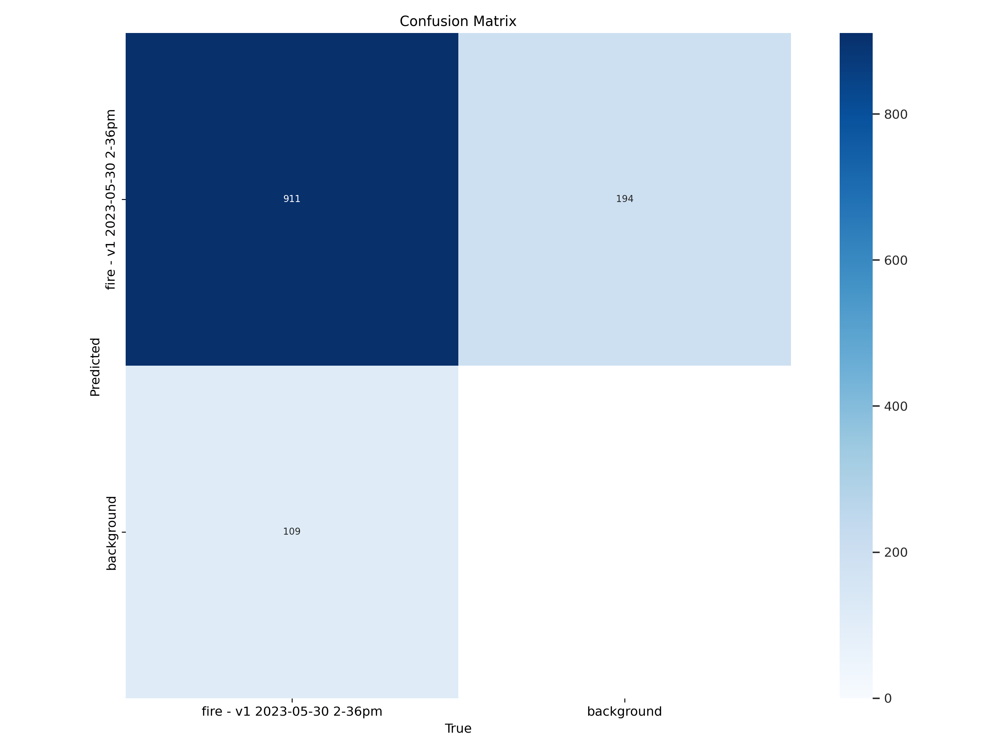

In [7]:
Image(filename=f'/content/runs/detect/train/confusion_matrix.png', width=600)

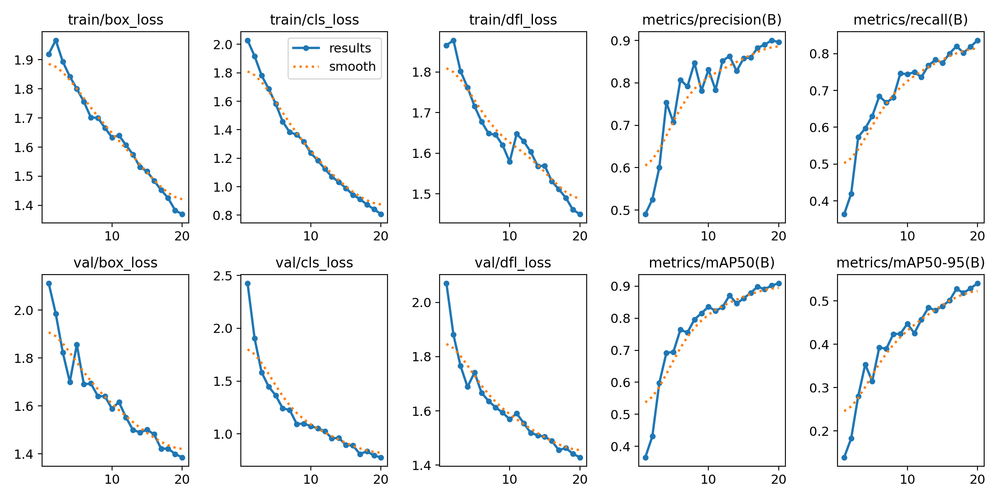

In [8]:
Image(filename=f'/content/runs/detect/train/results.png',width=600)

validation

In [9]:
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.1.9 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/FIRE-1/valid/labels.cache... 601 images, 5 backgrounds, 0 corrupt: 100% 601/601 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 38/38 [00:20<00:00,  1.89it/s]
                   all        601       1020      0.895      0.841      0.909       0.54
Speed: 0.6ms preprocess, 22.6ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


prediction sur l'ensemble de test

In [11]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.5 source='/content/FIRE-1/test/images'

Ultralytics YOLOv8.1.9 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

image 1/301 /content/FIRE-1/test/images/Img_1021_jpg.rf.51ff2cdd088b87a6b1730d5bc455841a.jpg: 640x640 1 fire - v1 2023-05-30 2-36pm, 37.0ms
image 2/301 /content/FIRE-1/test/images/Img_1024_jpg.rf.bc0a906acb153eadc21009f4bcaca485.jpg: 640x640 1 fire - v1 2023-05-30 2-36pm, 37.1ms
image 3/301 /content/FIRE-1/test/images/Img_1027_jpg.rf.9abd09e4700bf9353ed7943ae878cd3e.jpg: 640x640 1 fire - v1 2023-05-30 2-36pm, 37.0ms
image 4/301 /content/FIRE-1/test/images/Img_102_jpg.rf.28523eb46db5510c971eda9f1937e5f4.jpg: 640x640 1 fire - v1 2023-05-30 2-36pm, 37.0ms
image 5/301 /content/FIRE-1/test/images/Img_1034_jpg.rf.d8ad074554c3befba57b81830e904658.jpg: 640x640 1 fire - v1 2023-05-30 2-36pm, 37.0ms
image 6/301 /content/FIRE-1/test/images/Img_1035_jpg.rf.a4ef53a425354a51cae04da48259e4f8.jpg: 640x640 1 fire - v1 2023-05-30 2-36pm, 

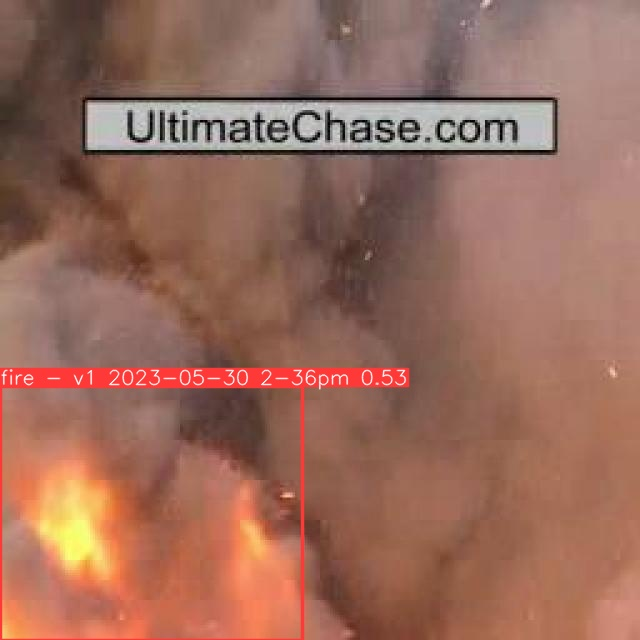

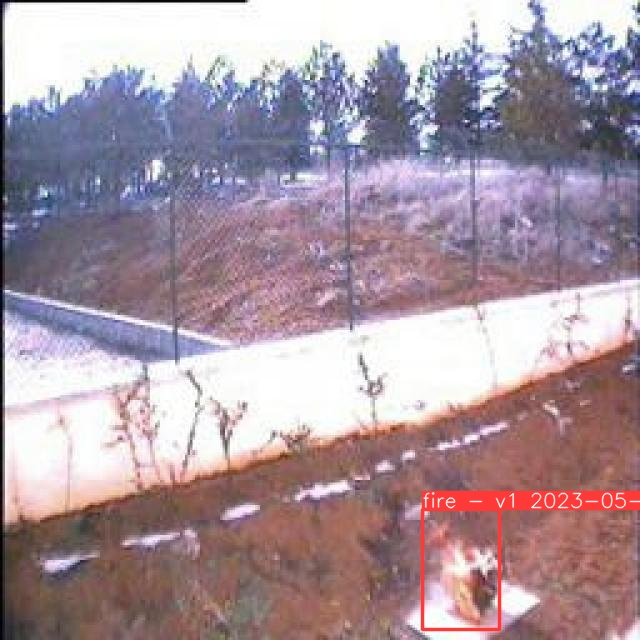

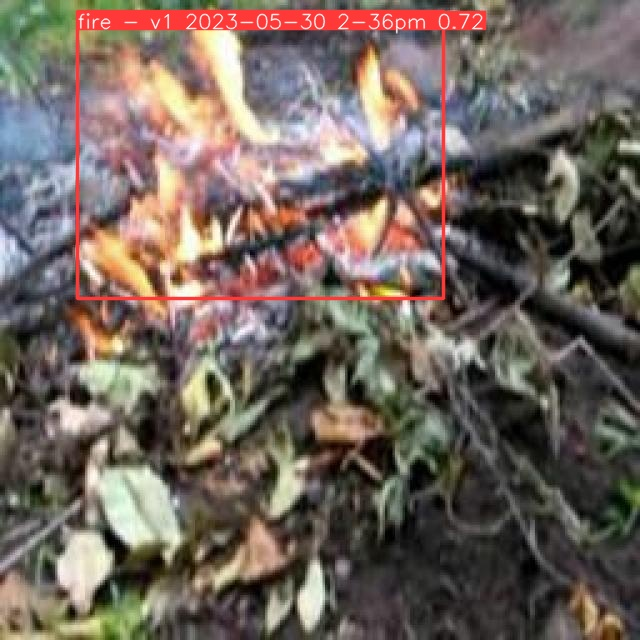

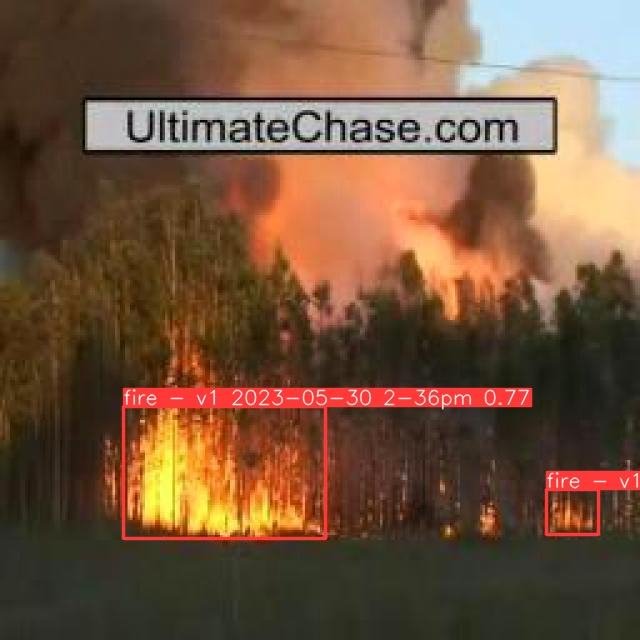

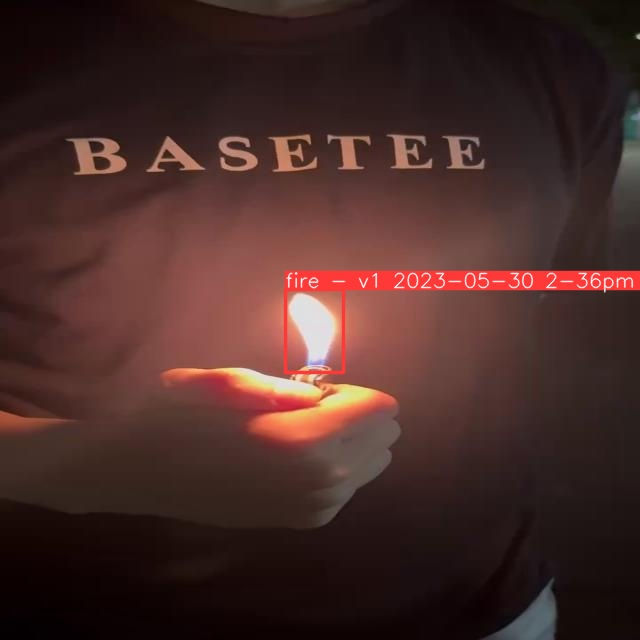

...

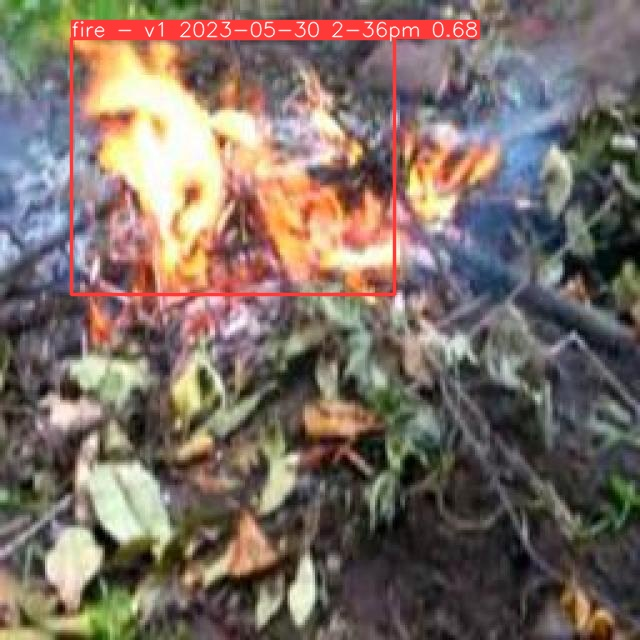

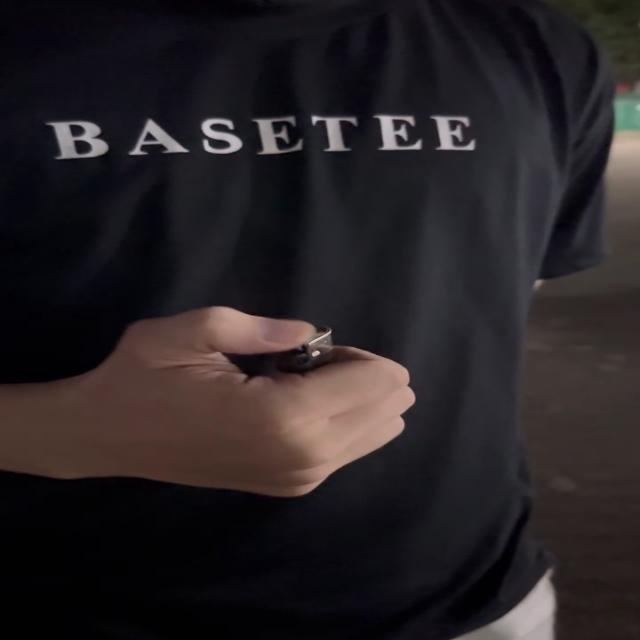

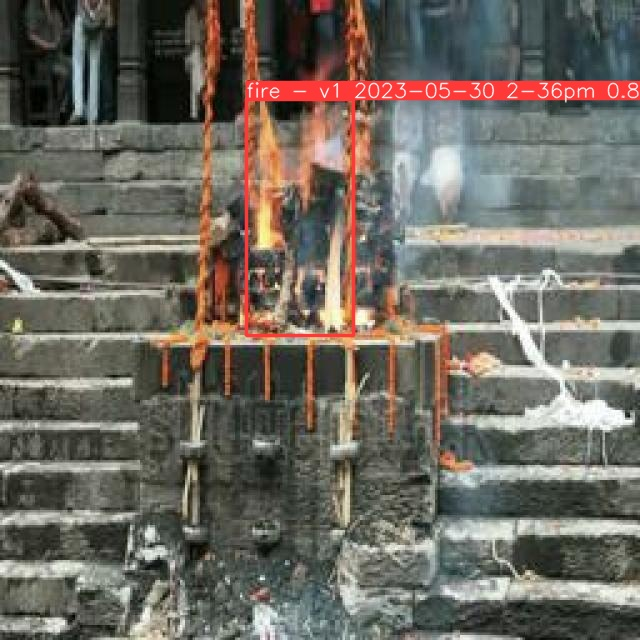

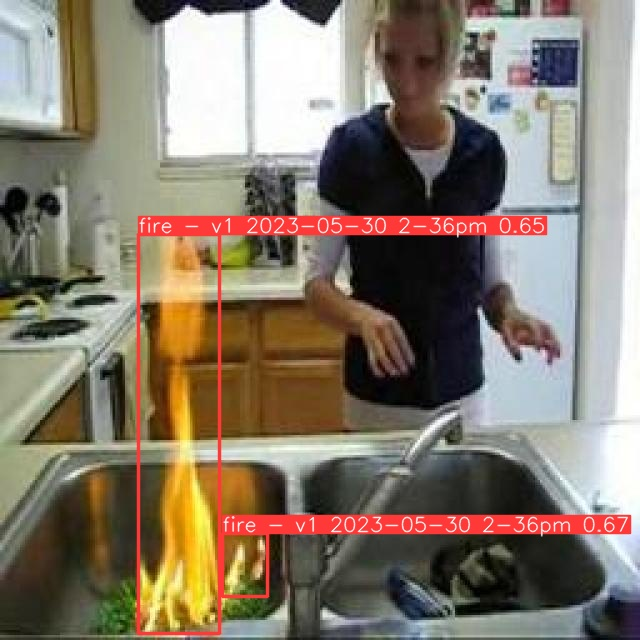

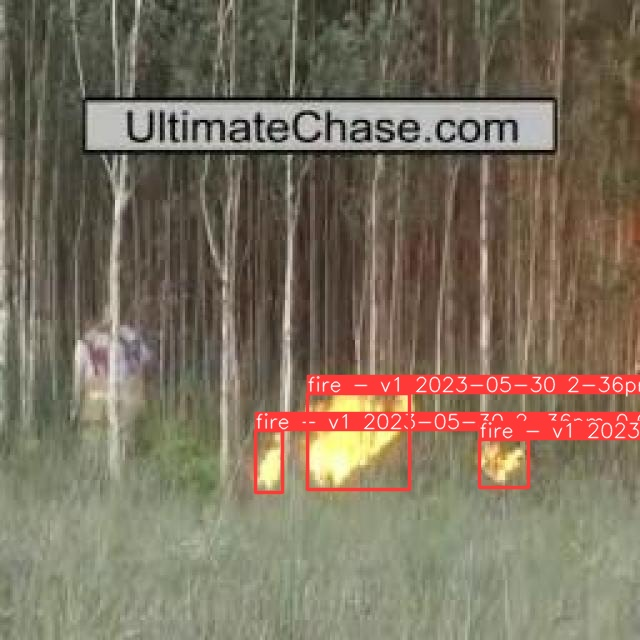

In [12]:
import glob
from IPython.display import display,Image
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg'):
  display(Image(filename=image_path,height=600))
  print("\n")